$\Large\color{blue}{\text{PyGMTSAR Sentinel-1 SLC Timeseries Analysis 2 Scenes 6 Subswaths 15m}}$

$\Large\color{blue}{\text{This notebook is optimized to work in Docker container (Ubuntu 22.04 Jammy) 16 GB RAM 1 GB swap 4 cores}}$

### PyGMTSAR is my free-time Open Source project.

That's a bit curious how the project was started a year ago. I develop geophysical inversion methods and processing software for many years using my fundamental physics and mathematics background. Satellite interferometry is the key point to validate my inversion models and I found the same problem as you too that the existing interferometry packages usage is a pain. There is no interactive processing with multiprocessing and even a progressbar and ability to view and change every step code and validate the results. Also, many used algorithms are too outdated and produce terrible results like to tension surfaces in GMT which is used widely in GMTSAR (hmm, how about to control a smothness of derivative? Tension surfaces were invented when all the Earths computers where less powerfull than your smarthone today. If you are interested I shared the examples in GMTSAR bug tracker). Anyway, I found GMT mathematics is really crazy and the developers replace one incorrect algorithm by another and back often as we see in the codes and the changelog). That was enough reason to check all the used algorithms and replace these by modern and correct ones. By this way, I use only GMTSAR C codes with my patches to fix some errors and allow interoperability with Python wrappers plus my own codes around them. GMTSAR codes are fine and without crazy GMT codes work better and the processing is much faster. Alright, I spent one month to make the initial PyGMTSAR realization and it works. Recently, I returned to the project to add some more sophisticated features like to scenes and subswathes stitching. I'm going to share some of my geological exprorations and seismic models as live examples on Google Colab as soon as it will be possible to do. How lineaments and ore zones are related to interferograms? How gas and oil deposits are related to surface movements on interferometry displacement maps? I have the answer and I work on the tools to model and visualize them.

You'd find my theoretical models and processing codes foir geophisical inversions in Github repository https://github.com/mobigroup/gis-snippets and tools for the 4D results vizualization in https://github.com/mobigroup/ParaView-plugins

Ah yes, a little bit about me. I have STEM master's degree in radio physics and in 2004 I was awarded first prize of the All-Russian Physics competition for significant results in Inverse modeling for non-linear optics and holography, also applicable for Inverse Modeling of Gravity, Magnetic, and Thermal fields. In addition to my fundamental science knowledge, I’m world class data scientist and software developer with 20 years experience in science and industrial development. I have worked on government contracts and universities projects and on projects for LG Corp, Google Inc, etc. You are able to find some of my software and results on LinkedIn and GitHub and Upwork. By the way, I left Russia many years ago and I work remotely for about 20 years.

### To order some research, development and support see my profile on freelance platform [Upwork](https://www.upwork.com/freelancers/~01e65e8e7221758623)

### @ Alexey Pechnikov, August, 2022

[Geological models on YouTube channel](https://www.youtube.com/channel/UCSEeXKAn9f_bDiTjT6l87Lg)

[Augmented Reality (AR) Geological Models](https://mobigroup.github.io/ParaView-Blender-AR/)

[GitHub repositories](https://github.com/mobigroup)

[English posts and articles on LinkedIn](https://www.linkedin.com/in/alexey-pechnikov/)

[Russian articles on Habr](https://habr.com/ru/users/N-Cube/posts/)

## Load Modules to Check Environment

In [1]:
import platform, sys, os

## Load and Setup Python Modules

In [2]:
import xarray as xr
import numpy as np
import pandas as pd
import geopandas as gpd
# supress numpy warnings
import warnings
warnings.filterwarnings('ignore')

In [3]:
# plotting modules
import hvplot.pandas  # noqa
import hvplot.xarray  # noqa
import holoviews as hv
pd.options.plotting.backend = 'hvplot'
from IPython.display import Image
import matplotlib.pyplot as plt
import matplotlib
%matplotlib inline

In [4]:
# define Pandas display settings
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)
pd.set_option('display.max_colwidth', None)

## Load Custom Python Modules

In [5]:
# default chunksize (512) is enough suitable for a single subswath processing using resolution 15m
# select higher chunk size (1024) to process multiple subswaths and scenes using resolution 15m
from pygmtsar import datagrid
datagrid.chunksize = 1024

In [6]:
# import the top level class
from pygmtsar import SBAS
# show progress indicator for the long operations
from pygmtsar import tqdm_dask

## Define 3 Sentinel-1 Scenes and Processing Parameters

## Common Configuration

In [7]:
ORBIT     = 'D'
#SUBSWATH  = 123
# common configuration
#DATADIR       = 'data_asc' if ORBIT == 'A' else 'data_desc'
#BACKUP       = 'backup_asc' if ORBIT == 'A' else 'backup_desc'
#BACKUP       = None
WORKDIR      = 'raw_asc' if ORBIT == 'A' else 'raw_desc'
#DEMFILE      = None
#POLARIZATION = 'VV'
# SBAS parameters
#BASEDAYS     = 65
#BASEMETERS   = 150
#RESOLUTION   = 15

In [8]:
# also, that's possible to unwrap without the threshold
CORRSTACKLIMIT = 0.15

## Run Local Dask Cluster

Launch Dask cluster for big data processing. Use "Dashboard" link below for the local cluster state and execution monitoring.

In [9]:
import dask, dask.distributed
# increase timeouts to work using default chunk size (512) even on large areas
dask.config.set({'distributed.comm.timeouts.tcp': '60s'})
#print (dask.config.get("distributed.comm.timeouts.tcp"))
dask.config.set({'distributed.comm.timeouts.connect': '60s'})
#print (dask.config.get("distributed.comm.timeouts.connect"))

from dask.distributed import Client, LocalCluster
cluster = LocalCluster(n_workers=1)
client = Client(cluster)
client

2022-11-22 18:43:10,935 - distributed.diskutils - INFO - Found stale lock file and directory '/tmp/dask-worker-space/worker-yc94ja5w', purging


Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: http://127.0.0.1:8787/status,
Dashboard: http://127.0.0.1:8787/status,Workers: 1
Total threads: 4,Total memory: 15.61 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:39729,Workers: 1
Dashboard: http://127.0.0.1:8787/status,Total threads: 4
Started: Just now,Total memory: 15.61 GiB
Comm: tcp://127.0.0.1:35459,Total threads: 4
Dashboard: http://127.0.0.1:33095/status,Memory: 15.61 GiB
Nanny: tcp://127.0.0.1:38343,


## Restore SBAS

In [10]:
sbas = SBAS.restore(WORKDIR)

NOTE: load state from file raw_desc/SBAS.pickle


In [11]:
sbas.to_dataframe()

,datetime,orbit,mission,polarization,subswath,datapath,metapath,orbitpath,geometry
date,,,,,,,,,
2022-01-09,2022-01-09 02:52:55,D,S1A,VV,123,"[raw_desc/s1a-iw1-slc-vv-20220109t025257-20220109t025347-041378-04eb6a-004.tiff, raw_desc/s1a-iw2-slc-vv-20220109t025255-20220109t025348-041378-04eb6a-005.tiff, raw_desc/s1a-iw3-slc-vv-20220109t025256-20220109t025346-041378-04eb6a-006.tiff]","[raw_desc/s1a-iw1-slc-vv-20220109t025257-20220109t025347-041378-04eb6a-004.xml, raw_desc/s1a-iw2-slc-vv-20220109t025255-20220109t025348-041378-04eb6a-005.xml, raw_desc/s1a-iw3-slc-vv-20220109t025256-20220109t025346-041378-04eb6a-006.xml]",data_desc/S1A_OPER_AUX_POEORB_OPOD_20220129T121556_V20220108T225942_20220110T005942.EOF,"POLYGON ((49.55044 39.58529, 48.78057 36.48907, 47.86206 36.71745, 47.82616 36.56834, 46.77516 36.82134, 46.78519 36.86300, 45.97606 37.03604, 46.63464 40.11560, 47.52247 39.92574, 47.56120 40.08664, 48.61221 39.83363, 48.60879 39.81943, 49.55044 39.58529))"
2022-01-21,2022-01-21 02:52:54,D,S1A,VV,123,"[raw_desc/s1a-iw1-slc-vv-20220121t025256-20220121t025346-041553-04f124-004.tiff, raw_desc/s1a-iw2-slc-vv-20220121t025254-20220121t025347-041553-04f124-005.tiff, raw_desc/s1a-iw3-slc-vv-20220121t025255-20220121t025345-041553-04f124-006.tiff]","[raw_desc/s1a-iw1-slc-vv-20220121t025256-20220121t025346-041553-04f124-004.xml, raw_desc/s1a-iw2-slc-vv-20220121t025254-20220121t025347-041553-04f124-005.xml, raw_desc/s1a-iw3-slc-vv-20220121t025255-20220121t025345-041553-04f124-006.xml]",data_desc/S1A_OPER_AUX_POEORB_OPOD_20220210T081610_V20220120T225942_20220122T005942.EOF,"POLYGON ((49.55021 39.58586, 48.78045 36.48963, 47.86190 36.71799, 47.82607 36.56913, 46.77504 36.82210, 46.78504 36.86366, 45.97598 37.03664, 46.63443 40.11620, 47.52221 39.92638, 47.56087 40.08703, 48.61191 39.83406, 48.60852 39.81997, 49.55021 39.58586))"
2022-02-02,2022-02-02 02:52:54,D,S1A,VV,123,"[raw_desc/s1a-iw1-slc-vv-20220202t025256-20220202t025346-041728-04f723-004.tiff, raw_desc/s1a-iw2-slc-vv-20220202t025254-20220202t025346-041728-04f723-005.tiff, raw_desc/s1a-iw3-slc-vv-20220202t025255-20220202t025345-041728-04f723-006.tiff]","[raw_desc/s1a-iw1-slc-vv-20220202t025256-20220202t025346-041728-04f723-004.xml, raw_desc/s1a-iw2-slc-vv-20220202t025254-20220202t025346-041728-04f723-005.xml, raw_desc/s1a-iw3-slc-vv-20220202t025255-20220202t025345-041728-04f723-006.xml]",data_desc/S1A_OPER_AUX_POEORB_OPOD_20220222T081603_V20220201T225942_20220203T005942.EOF,"POLYGON ((49.54992 39.58491, 48.78032 36.48917, 47.86182 36.71751, 47.82594 36.56841, 46.77495 36.82136, 46.78495 36.86293, 45.97585 37.03591, 46.63417 40.11510, 47.52200 39.92529, 47.56072 40.08617, 48.61171 39.83322, 48.60829 39.81900, 49.54992 39.58491))"
2022-02-14,2022-02-14 02:52:54,D,S1A,VV,123,"[raw_desc/s1a-iw1-slc-vv-20220214t025256-20220214t025346-041903-04fd3e-004.tiff, raw_desc/s1a-iw2-slc-vv-20220214t025254-20220214t025347-041903-04fd3e-005.tiff, raw_desc/s1a-iw3-slc-vv-20220214t025255-20220214t025345-041903-04fd3e-006.tiff]","[raw_desc/s1a-iw1-slc-vv-20220214t025256-20220214t025346-041903-04fd3e-004.xml, raw_desc/s1a-iw2-slc-vv-20220214t025254-20220214t025347-041903-04fd3e-005.xml, raw_desc/s1a-iw3-slc-vv-20220214t025255-20220214t025345-041903-04fd3e-006.xml]",data_desc/S1A_OPER_AUX_POEORB_OPOD_20220306T081614_V20220213T225942_20220215T005942.EOF,"POLYGON ((49.54920 39.58515, 48.77939 36.48867, 47.86097 36.71699, 47.82509 36.56790, 46.77415 36.82084, 46.78415 36.86241, 45.97506 37.03540, 46.63355 40.11510, 47.52134 39.92528, 47.56006 40.08615, 48.61100 39.83321, 48.60763 39.81923, 49.54920 39.58515))"
2022-02-26,2022-02-26 02:52:54,D,S1A,VV,123,"[raw_desc/s1a-iw1-slc-vv-20220226t025256-20220226t025345-042078-050346-004.tiff, raw_desc/s1a-iw2-slc-vv-20220226t025254-20220226t025346-042078-050346-005.tiff, raw_desc/s1a-iw3-slc-vv-20220226t025255-20220226t025345-042078-050346-006.tiff]","[raw_desc/s1a-iw1-slc-vv-20220226t025256-20220226t025345-042078-050346-004.xml, raw_desc/s1a-iw2-slc-vv-20220226t02

## Find SBAS Pairs

Scan work directory to find all the processed pairs

In [12]:
pairs = sbas.find_pairs()
pairs

array([['20220109', '20220121'],
       ['20220109', '20220202'],
       ['20220109', '20220214'],
       ['20220109', '20220226'],
       ['20220109', '20220310'],
       ['20220121', '20220202'],
       ['20220121', '20220214'],
       ['20220121', '20220226'],
       ['20220121', '20220310'],
       ['20220121', '20220322'],
       ['20220202', '20220214'],
       ['20220202', '20220226'],
       ['20220202', '20220310'],
       ['20220202', '20220322'],
       ['20220202', '20220403'],
       ['20220214', '20220226'],
       ['20220214', '20220310'],
       ['20220214', '20220322'],
       ['20220214', '20220403'],
       ['20220214', '20220415'],
       ['20220226', '20220310'],
       ['20220226', '20220322'],
       ['20220226', '20220403'],
       ['20220226', '20220415'],
       ['20220226', '20220427'],
       ['20220310', '20220322'],
       ['20220310', '20220415'],
       ['20220310', '20220427'],
       ['20220322', '20220403'],
       ['20220322', '20220415'],
       ['2

## Build Decimator for Plots

Large grid plots require a lot of RAM so decimate plots to build smaller images visually almost the same as the original ones.

In [13]:
# decimate arrays to plot
decimator = sbas.pixel_decimator(resolution_meters=300, debug=True)

DEBUG: average per subswaths ground pixel size in meters: y=14.0, x=14.6
DEBUG: decimator = lambda da: da.coarsen({'y': 21, 'x': 21}, boundary='trim').mean()


## Build Geocoding Matrices

Geocoding matrices required to produce geographic coordinates (lat, lon) outputs and to convert land mask to radar coordinates for unwrapping.

In [17]:
sbas.geocode_parallel()

Radar Transform Computing:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

Analyze Transform Blocks:   0%|          | 0/676 [00:00<?, ?it/s]

Radar Topography Computing:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

Loading:   0%|          | 0/34 [00:00<?, ?it/s]

Analyze Transform Blocks:   0%|          | 0/676 [00:00<?, ?it/s]

Build ll2ra Transform:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

Build ra2ll Transform:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

## Build Correlation Stack Mask

Use stacked correlation average value to exclude low-coherent areas like to water surfaces

In [18]:
corrs = sbas.open_grids(pairs, 'corr')
corrs

Loading:   0%|          | 0/34 [00:00<?, ?it/s]

<xarray.DataArray 'z' (pair: 34, y: 25613, x: 17029)>
dask.array<concatenate, shape=(34, 25613, 17029), dtype=float32, chunksize=(1, 1024, 1024), chunktype=numpy.ndarray>
Coordinates:
  * x        (x) float64 2.0 6.0 10.0 14.0 ... 6.811e+04 6.811e+04 6.811e+04
  * y        (y) float64 0.5 1.5 2.5 3.5 ... 2.561e+04 2.561e+04 2.561e+04
  * pair     (pair) <U17 '20220109 20220121' ... '20220415 20220427'
    ref      (pair) <U8 '20220109' '20220109' ... '20220403' '20220415'
    rep      (pair) <U8 '20220121' '20220202' ... '20220427' '20220427'
Attributes:
    long_name:     z
    actual_range:  [0.0030831  0.99798828]

In [19]:
%%time

# calculate correlation stack on lazy dask arrays
corr_stack = corrs.mean('pair')
corr_stack

CPU times: user 93.9 ms, sys: 13.6 ms, total: 108 ms
Wall time: 102 ms


<xarray.DataArray 'z' (y: 25613, x: 17029)>
dask.array<mean_agg-aggregate, shape=(25613, 17029), dtype=float32, chunksize=(1024, 1024), chunktype=numpy.ndarray>
Coordinates:
  * x        (x) float64 2.0 6.0 10.0 14.0 ... 6.811e+04 6.811e+04 6.811e+04
  * y        (y) float64 0.5 1.5 2.5 3.5 ... 2.561e+04 2.561e+04 2.561e+04

In [20]:
# create binary mask and materialize the result for repeated usage
corr_mask = xr.where(corr_stack >= CORRSTACKLIMIT,1,0).astype(bool).persist()
tqdm_dask(corr_mask, desc='Build Correlation Stack Coherency Binary Mask')
corr_mask

Build Correlation Stack Coherency Binary Mask:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

2022-11-22 20:08:39,203 - distributed.worker_memory - WARNING - gc.collect() took 3.754s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2022-11-22 20:10:47,417 - distributed.worker_memory - WARNING - gc.collect() took 3.242s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2022-11-22 20:12:41,635 - distributed.worker_memory - WARNING - gc.collect() took 3.766s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.


<xarray.DataArray 'z' (y: 25613, x: 17029)>
dask.array<astype, shape=(25613, 17029), dtype=bool, chunksize=(1024, 1024), chunktype=numpy.ndarray>
Coordinates:
  * x        (x) float64 2.0 6.0 10.0 14.0 ... 6.811e+04 6.811e+04 6.811e+04
  * y        (y) float64 0.5 1.5 2.5 3.5 ... 2.561e+04 2.561e+04 2.561e+04

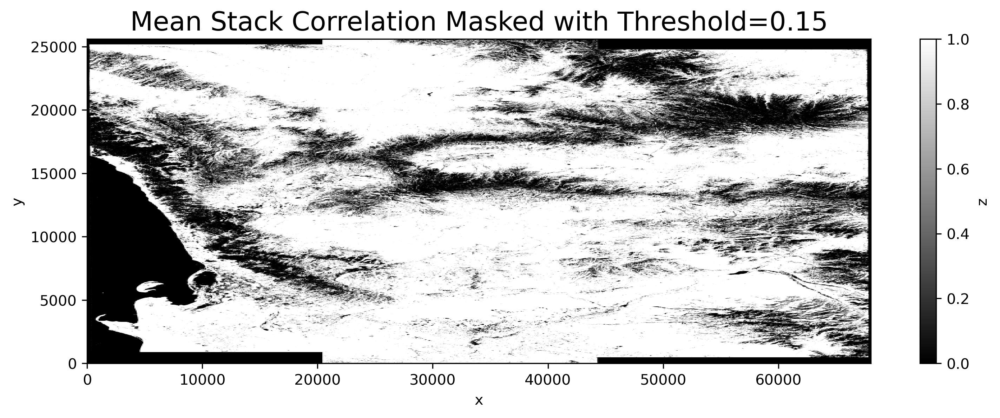

In [21]:
plt.figure(figsize=(12,4), dpi=300)
decimator(corr_mask).plot.imshow(vmin=0, vmax=1, cmap='gray')
plt.title(f'Mean Stack Correlation Masked with Threshold={CORRSTACKLIMIT}', fontsize=18)
plt.show()

## Define Land Mask

Exclude large water surfaces.

In [22]:
sbas.download_landmask()

Landmask Downloading:   0%|          | 0/1 [00:00<?, ?it/s]

In [23]:
# materialize the grid to reused it multiple times below
landmask = sbas.get_landmask(inverse_geocode=True).astype(bool).compute()

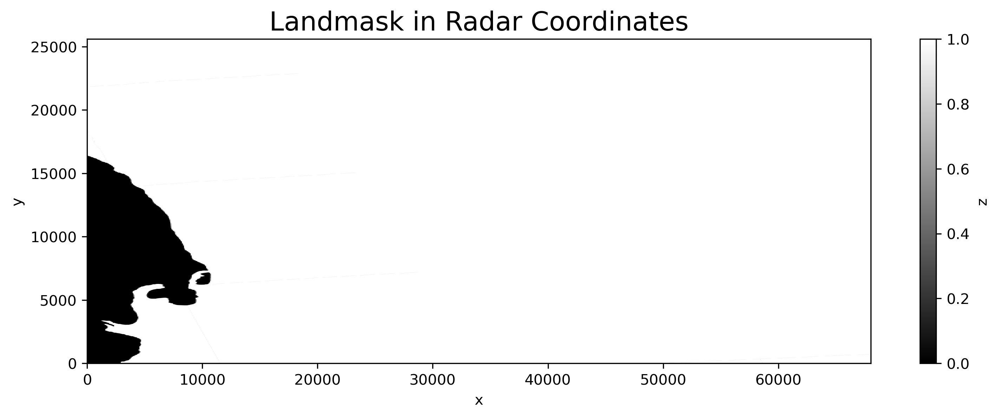

In [24]:
plt.figure(figsize=(12,4), dpi=300)
decimator(landmask).plot.imshow(cmap='gray')
plt.title('Landmask in Radar Coordinates', fontsize=18)
plt.show()

## Define Composite Mask

In [25]:
# merge binary masks
#composite_mask = corr_mask & user_mask
composite_mask = corr_mask & landmask

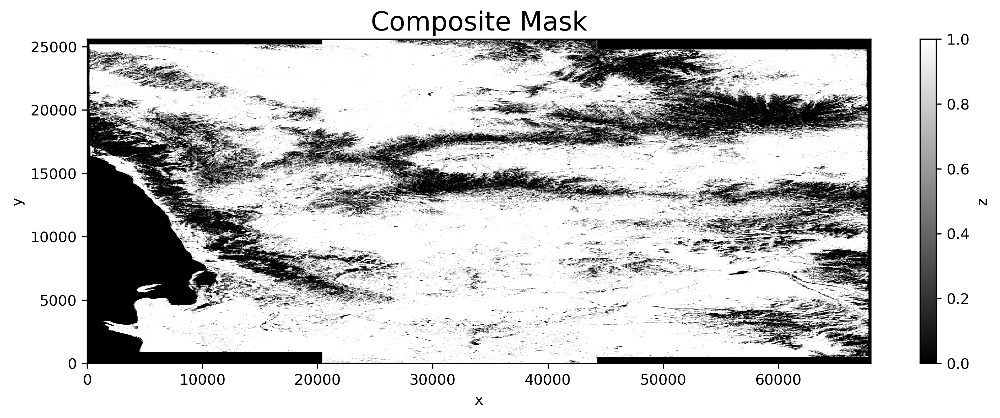

In [26]:
plt.figure(figsize=(12,4), dpi=300)
decimator(composite_mask).plot.imshow(cmap='gray')
plt.title('Composite Mask', fontsize=18)
plt.show()

## Unwrapping

In [27]:
# define a post-processing function to crop low-coherence areas
#cleaner = lambda corr, unwrap: xr.where(corr>0, unwrap, np.nan)

# define a post-processing function to crop and interpolate low-coherence areas
#cleaner = lambda corr, unwrap: sbas.nearest_grid(xr.where(corr>=CORRLIMIT, unwrap, np.nan))

In [28]:
# tiled SNAPHU config is helpful to unwrap large areas
# use NPROC parameter to define number of cores for the processing, by default all the cores used
#snaphu Exceeded maximum number of secondary arcs
#Decrease TILECOSTTHRESH and/or increase MINREGIONSIZE
#TILECOSTTHRESH=250, MINREGIONSIZE=200, 
conf = sbas.PRM().snaphu_config(NTILEROW=16, NTILECOL=16, ROWOVRLP=200, COLOVRLP=200, SINGLETILEREOPTIMIZE=False)

In [29]:
# check the generated SNAPHU config and tune the SNAPHU parameters above if needed.
print ('SNAPHU custom config generated:')
print (conf)

SNAPHU custom config generated:

    # basic config
    INFILEFORMAT   FLOAT_DATA
    OUTFILEFORMAT  FLOAT_DATA
    AMPFILEFORMAT  FLOAT_DATA
    CORRFILEFORMAT FLOAT_DATA
    ALTITUDE       693000.0
    EARTHRADIUS    6378000.0
    NEARRANGE      831000
    DR             18.4
    DA             28.2
    RANGERES       28
    AZRES          44
    LAMBDA         0.0554658
    NLOOKSRANGE    1
    NLOOKSAZ       1
    DEFOMAX_CYCLE  0
    TILEDIR        raw_desc/S1_20220202_ALL_F123_snaphu_tiledir
    NPROC          4
    # custom config
    NTILEROW 16
    NTILECOL 16
    ROWOVRLP 200
    COLOVRLP 200
    SINGLETILEREOPTIMIZE FALSE



## Unwrap One

In [30]:
phase = sbas.open_grids(pairs[:1], 'phasefilt')[0]
phase

Loading:   0%|          | 0/1 [00:00<?, ?it/s]

<xarray.DataArray 'z' (y: 25613, x: 17029)>
dask.array<getitem, shape=(25613, 17029), dtype=float32, chunksize=(1024, 1024), chunktype=numpy.ndarray>
Coordinates:
  * x        (x) float64 2.0 6.0 10.0 14.0 ... 6.811e+04 6.811e+04 6.811e+04
  * y        (y) float64 0.5 1.5 2.5 3.5 ... 2.561e+04 2.561e+04 2.561e+04
    pair     <U17 '20220109 20220121'
    ref      <U8 '20220109'
    rep      <U8 '20220121'
Attributes:
    long_name:     z
    actual_range:  [-3.14159274  3.14159274]

In [31]:
corr = sbas.open_grids(pairs[:1], 'corr')[0]
corr

Loading:   0%|          | 0/1 [00:00<?, ?it/s]

<xarray.DataArray 'z' (y: 25613, x: 17029)>
dask.array<getitem, shape=(25613, 17029), dtype=float32, chunksize=(1024, 1024), chunktype=numpy.ndarray>
Coordinates:
  * x        (x) float64 2.0 6.0 10.0 14.0 ... 6.811e+04 6.811e+04 6.811e+04
  * y        (y) float64 0.5 1.5 2.5 3.5 ... 2.561e+04 2.561e+04 2.561e+04
    pair     <U17 '20220109 20220121'
    ref      <U8 '20220109'
    rep      <U8 '20220121'
Attributes:
    long_name:     z
    actual_range:  [0.0030831  0.99798828]

### Use Composite Mask

Usually this is the best way for SBAS analysis because we define well-coherent pixels for the stack

In [32]:
%%time

sbas.unwrap(pairs[0], mask=composite_mask, conf=conf, conncomp=True, interactive=False)

CPU times: user 1min 6s, sys: 59.9 s, total: 2min 6s
Wall time: 23min 43s


In [33]:
unwrap = sbas.open_grids(pairs[:1], 'unwrap')[0]
conn = sbas.open_grids(pairs[:1], 'conncomp')[0]

Loading:   0%|          | 0/1 [00:00<?, ?it/s]

Loading:   0%|          | 0/1 [00:00<?, ?it/s]

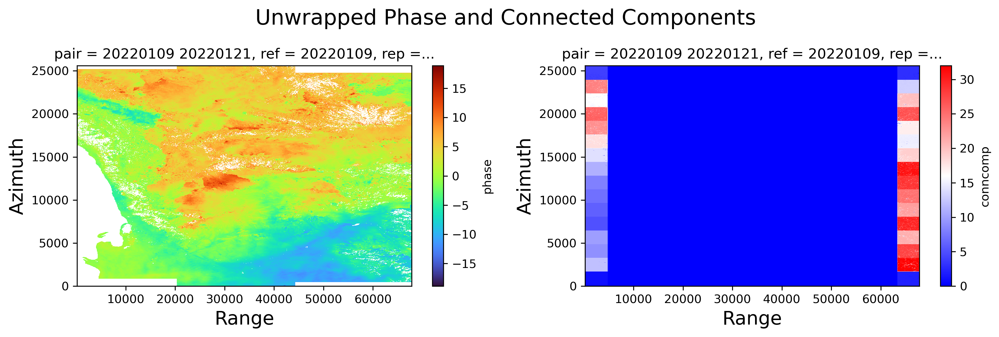

In [34]:
fig = plt.figure(figsize=(12,4), dpi=300)

ax = fig.add_subplot(1, 2, 1)
decimator(unwrap).plot.imshow(cmap='turbo', ax=ax)
plt.xlabel('Range', fontsize=16)
plt.ylabel('Azimuth', fontsize=16)
#plt.title('Subswath', fontsize=18)

ax = fig.add_subplot(1, 2, 2)
decimator(conn).plot.imshow(cmap='bwr', ax=ax)
plt.xlabel('Range', fontsize=16)
plt.ylabel('Azimuth', fontsize=16)
#plt.title('Subswath', fontsize=18)

plt.suptitle('Unwrapped Phase and Connected Components', fontsize=18)
plt.tight_layout()
plt.show()

### Use Land Mask and Correlation Threshold

Correlation threshold applies to separate interferograms and so the same pixel can be defined or empty for the stack. That's not the best for SBAS analysis and often the unwrapping result is not stable. That's possible to interpolate missed (low-coherent) values using the post-processing function to perform SBAS analysis:
cleaner = lambda corr, unwrap: sbas.nearest_grid(xr.where(corr>=CORRLIMIT, unwrap, np.nan))

In [35]:
%%time

sbas.unwrap(pairs[0], threshold=CORRSTACKLIMIT, mask=landmask, conf=conf, conncomp=True, interactive=False)

CPU times: user 3min 4s, sys: 1min 10s, total: 4min 15s
Wall time: 1h 16min 17s


In [36]:
unwrap = sbas.open_grids(pairs[:1], 'unwrap')[0]
conn = sbas.open_grids(pairs[:1], 'conncomp')[0]

Loading:   0%|          | 0/1 [00:00<?, ?it/s]

Loading:   0%|          | 0/1 [00:00<?, ?it/s]

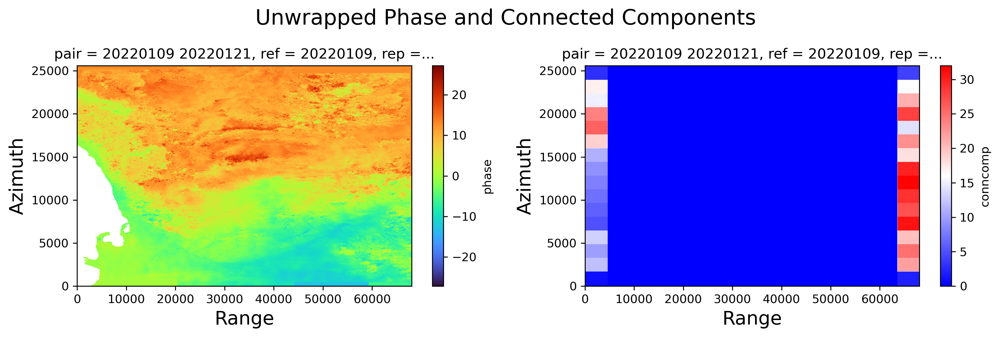

In [37]:
fig = plt.figure(figsize=(12,4), dpi=300)

ax = fig.add_subplot(1, 2, 1)
decimator(unwrap).plot.imshow(cmap='turbo', ax=ax)
plt.xlabel('Range', fontsize=16)
plt.ylabel('Azimuth', fontsize=16)
#plt.title('Subswath', fontsize=18)

ax = fig.add_subplot(1, 2, 2)
decimator(conn).plot.imshow(cmap='bwr', ax=ax)
plt.xlabel('Range', fontsize=16)
plt.ylabel('Azimuth', fontsize=16)
#plt.title('Subswath', fontsize=18)

plt.suptitle('Unwrapped Phase and Connected Components', fontsize=18)
plt.tight_layout()
plt.show()

### Use Composite Mask and Correlation Threshold

Correlation threshold applies to separate interferograms and so the same pixel can be defined or empty for the stack. That's not the best for SBAS analysis and often the unwrapping result is not stable. That's possible to interpolate missed (low-coherent) values using the post-processing function to perform SBAS analysis:
cleaner = lambda corr, unwrap: sbas.nearest_grid(xr.where(corr>=CORRLIMIT, unwrap, np.nan))

In [38]:
%%time

sbas.unwrap(pairs[0], threshold=CORRSTACKLIMIT, mask=composite_mask, conf=conf, conncomp=True, interactive=False)

CPU times: user 55.1 s, sys: 36.7 s, total: 1min 31s
Wall time: 22min 18s


In [39]:
unwrap = sbas.open_grids(pairs[:1], 'unwrap')[0]
conn = sbas.open_grids(pairs[:1], 'conncomp')[0]

Loading:   0%|          | 0/1 [00:00<?, ?it/s]

Loading:   0%|          | 0/1 [00:00<?, ?it/s]

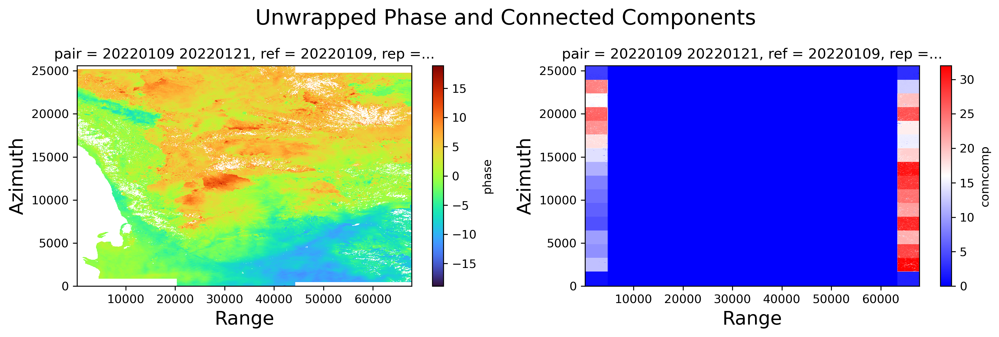

In [40]:
fig = plt.figure(figsize=(12,4), dpi=300)

ax = fig.add_subplot(1, 2, 1)
decimator(unwrap).plot.imshow(cmap='turbo', ax=ax)
plt.xlabel('Range', fontsize=16)
plt.ylabel('Azimuth', fontsize=16)
#plt.title('Subswath', fontsize=18)

ax = fig.add_subplot(1, 2, 2)
decimator(conn).plot.imshow(cmap='bwr', ax=ax)
plt.xlabel('Range', fontsize=16)
plt.ylabel('Azimuth', fontsize=16)
#plt.title('Subswath', fontsize=18)

plt.suptitle('Unwrapped Phase and Connected Components', fontsize=18)
plt.tight_layout()
plt.show()

## Unwrap All

Use the best unwrapping parameters defined above for all the interferograms

In [41]:
# on 8 cores CPU use 4 job for 4-core multi-tile snaphu processing on large areas
# correlation threshold drops low coherence areas on this interferogram
# stack coherency mask drops low coherence areas in average
sbas.unwrap_parallel(mask=composite_mask, conf=conf, n_jobs=1)

Unwrapping:   0%|          | 0/34 [00:00<?, ?it/s]

## Load and Display Top 15 Unwrapped Phase

In [42]:
# decimate to plot faster
unwraps = decimator(sbas.open_grids(pairs[:15], 'unwrap'))

Loading:   0%|          | 0/15 [00:00<?, ?it/s]

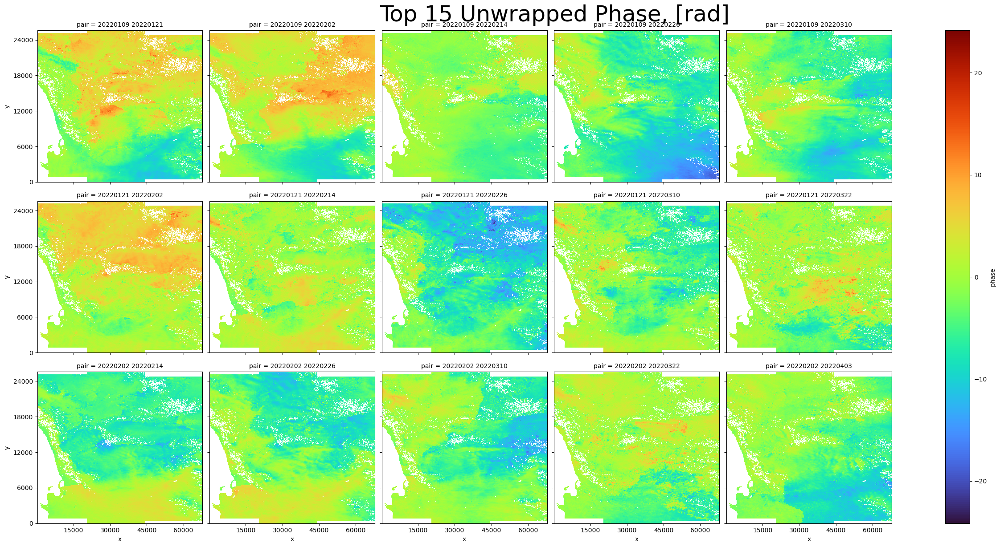

CPU times: user 1min 44s, sys: 7.41 s, total: 1min 51s
Wall time: 8min 11s


In [43]:
%%time

fg = unwraps.plot.imshow(
    col='pair',
    col_wrap=5, size=4, aspect=1.2,
    cmap='turbo'
)
fg.set_ticks(max_xticks=5, max_yticks=5, fontsize='medium')
fg.fig.suptitle('Top 15 Unwrapped Phase, [rad]', y=1.02, fontsize=36)
#plt.savefig(f'Unwrapped Phase, [rad].jpg', dpi=150, quality=95)
plt.show()

## Done

All the interferograms unwrapped the project can be restored later to continue the analysis. That's safer to create a new notebook for the post-processing because plotting a large timeseries requires a lot of RAM and the notebook can be out of RAM at any time.